In [1]:
import torch


In [17]:
#pip install opencv-python

In [18]:
#pip install -q ultralytics imutils

In [ ]:
# "C://Users//Darpan//Desktop//DL Codes//Datasets//VisDrone//VisDrone2019-DET-test-dev//annotations"
# "C://Users//Darpan//Desktop//DL Codes//Datasets//VisDrone//VisDrone2019-DET-test-dev//images"
# "C://Users//Darpan//Desktop//DL Codes//Datasets//VisDrone//VisDrone2019-DET-train//annotations"
# "C://Users//Darpan//Desktop//DL Codes//Datasets//VisDrone//VisDrone2019-DET-train//images"
# "C://Users//Darpan//Desktop//DL Codes//Datasets//VisDrone//VisDrone2019-DET-val//annotations"
# "C://Users//Darpan//Desktop//DL Codes//Datasets//VisDrone//VisDrone2019-DET-val//images"


In [43]:
# #Converting VisDrone annotations of txt format(10 column) to yolo format (5 column) for each train , test , val


# import os
# from tqdm import tqdm

# # Set your paths
# visdrone_ann_dir = "C://Users//Darpan//Desktop//DL Codes//Datasets//VisDrone//VisDrone2019-DET-train//annotations"
# visdrone_img_dir = "C://Users//Darpan//Desktop//DL Codes//Datasets//VisDrone//VisDrone2019-DET-train//images"
# output_img_dir = "C://Users//Darpan//Desktop//DL Codes//Datasets//VisDrone//images//train"
# output_lbl_dir = "C://Users//Darpan//Desktop//DL Codes//Datasets//VisDrone//labels//train"

# os.makedirs(output_img_dir, exist_ok=True)
# os.makedirs(output_lbl_dir, exist_ok=True)

# # Class mapping: VisDrone uses class IDs from 0–10 (class 0–9 = valid, 10 = ignored)
# valid_class_ids = list(range(10))  # Classes 0–9 are valid

# def convert_to_yolo(x, y, w, h, img_w, img_h):
#     x_c = (x + w / 2) / img_w
#     y_c = (y + h / 2) / img_h
#     return x_c, y_c, w / img_w, h / img_h

# # Process all annotation files
# for filename in tqdm(os.listdir(visdrone_ann_dir)):
#     if not filename.endswith(".txt"):
#         continue

#     ann_path = os.path.join(visdrone_ann_dir, filename)
#     img_name = filename.replace(".txt", ".jpg")
#     img_path = os.path.join(visdrone_img_dir, img_name)

#     # Skip if image does not exist
#     if not os.path.exists(img_path):
#         continue

#     # Copy image to output
#     os.system(f'copy "{img_path}" "{output_img_dir}"')

#     # Read annotation file
#     with open(ann_path, 'r') as f:
#         lines = f.readlines()

#     yolo_lines = []
#     for line in lines:
#         parts = line.strip().split(',')
#         if len(parts) != 8:
#             continue
    
#         x, y, w, h, score, obj_class, trunc, occ = map(int, parts)
    
#         # Skip class 10 or invalid class
#         if obj_class == 10:
#             continue
    
#         # Read image to get width and height
#         img = cv2.imread(img_path)
#         if img is None:
#             continue
#         img_h, img_w = img.shape[:2]
    
#         # Convert to YOLO format
#         x_c, y_c, w_n, h_n = convert_to_yolo(x, y, w, h, img_w, img_h)
#         yolo_lines.append(f"{obj_class} {x_c:.6f} {y_c:.6f} {w_n:.6f} {h_n:.6f}")



#     # Save converted labels
#     label_file = os.path.join(output_lbl_dir, filename)
#     with open(label_file, 'w') as f:
#         f.write("\n".join(yolo_lines))


100%|██████████████████████████████████████████████████████████████████████████████| 6471/6471 [56:12<00:00,  1.92it/s]


In [58]:
import os
from tqdm import tqdm
import cv2

# Set your paths
visdrone_ann_dir = "C:/Users/Darpan/Desktop/DL Codes/Datasets/VisDrone/VisDrone2019-DET-test-dev/annotations"
visdrone_img_dir = "C:/Users/Darpan/Desktop/DL Codes/Datasets/VisDrone/VisDrone2019-DET-test-dev/images"
output_img_dir = "C://Users//Darpan//Desktop//DL Codes//Datasets//VisDrone//images1//test_dev"
output_lbl_dir = "C://Users//Darpan//Desktop//DL Codes//Datasets//VisDrone//labels1//test_dev"

os.makedirs(output_img_dir, exist_ok=True)
os.makedirs(output_lbl_dir, exist_ok=True)

# Class mapping: VisDrone uses class IDs from 0–10 (class 0–9 = valid, 10+ = ignored)
valid_class_ids = list(range(10))  # Classes 0–9 are valid

def convert_to_yolo(x, y, w, h, img_w, img_h):
    x_c = (x + w / 2) / img_w
    y_c = (y + h / 2) / img_h
    return x_c, y_c, w / img_w, h / img_h

# Process all annotation files
for filename in tqdm(os.listdir(visdrone_ann_dir)):
    if not filename.endswith(".txt"):
        continue

    ann_path = os.path.join(visdrone_ann_dir, filename)
    img_name = filename.replace(".txt", ".jpg")
    img_path = os.path.join(visdrone_img_dir, img_name)

    # Skip if image does not exist
    if not os.path.exists(img_path):
        continue

    # Copy image to output
    os.system(f'copy "{img_path}" "{output_img_dir}"')

    # Read annotation file
    with open(ann_path, 'r') as f:
        lines = f.readlines()

    yolo_lines = []
    img = cv2.imread(img_path)
    img_h, img_w = img.shape[:2]

    for line in lines:
        parts = line.strip().split(',')
        if len(parts) < 6:
            continue

        x, y, w, h = map(int, parts[:4])
        class_id = int(parts[5])

        if class_id not in valid_class_ids:
            continue

        x_c, y_c, w_n, h_n = convert_to_yolo(x, y, w, h, img_w, img_h)
        yolo_lines.append(f"{class_id} {x_c:.6f} {y_c:.6f} {w_n:.6f} {h_n:.6f}")

    # Save converted labels if any valid lines exist
    if yolo_lines:
        label_file = os.path.join(output_lbl_dir, filename)
        with open(label_file, 'w') as f:
            f.write("\n".join(yolo_lines))


100%|██████████████████████████████████████████████████████████████████████████████| 1610/1610 [00:37<00:00, 42.52it/s]


In [2]:
from tqdm.auto import tqdm

import os
import requests
import zipfile
import cv2
import math

import matplotlib.pyplot as plt
import glob
import numpy as np
import random

from PIL import Image

In [3]:
ROOT_DIR = "C:\\Users\\Darpan\\Desktop\\DL Codes\\Datasets\\VisDrone"
train_imgs_dir = "C:\\Users\\Darpan\\Desktop\\DL Codes\\Datasets\\VisDrone\\images1\\train"
train_labels_dir = "C:\\Users\\Darpan\\Desktop\\DL Codes\\Datasets\\VisDrone\\labels1\\train"
val_imgs_dir = "C:\\Users\\Darpan\\Desktop\\DL Codes\\Datasets\\VisDrone\\images1\\val"
val_labels_dir = "C:\\Users\\Darpan\\Desktop\\DL Codes\\Datasets\\VisDrone\\labels1\\val"
test_imgs_dir = "C:\\Users\\Darpan\\Desktop\\DL Codes\\Datasets\\VisDrone\\images1\\test_dev"
test_labels_dir = "C:\\Users\\Darpan\\Desktop\\DL Codes\\Datasets\\VisDrone\\labels1\\test_dev"
classes = [
    'pedestrian',
    'people',
    'bicycle',
    'car',
    'van',
    'truck',
    'tricycle',
    'awning-tricycle',
    'bus',
    'motor',
    'other'
]
colors = np.random.uniform(0, 255, size=(len(classes), 3))

In [4]:
# Function to convert bounding boxes in YOLO format to xmin, ymin, xmax, ymax.
def yolo2bbox(bboxes):
    xmin, ymin = bboxes[0]-bboxes[2]/2, bboxes[1]-bboxes[3]/2
    xmax, ymax = bboxes[0]+bboxes[2]/2, bboxes[1]+bboxes[3]/2
    return xmin, ymin, xmax, ymax

In [5]:
def plot_box(image, bboxes, labels, classes=classes, colors=colors, pos='above'):
    # Need the image height and width to denormalize
    # the bounding box coordinates
    height, width, _ = image.shape
    lw = max(round(sum(image.shape) / 2 * 0.003), 2)  # Line width.
    tf = max(lw - 1, 1) # Font thickness.
    for box_num, box in enumerate(bboxes):
        x1, y1, x2, y2 = yolo2bbox(box)
        # denormalize the coordinates
        xmin = int(x1*width)
        ymin = int(y1*height)
        xmax = int(x2*width)
        ymax = int(y2*height)

        p1, p2 = (int(xmin), int(ymin)), (int(xmax), int(ymax))
        
        class_name = classes[int(labels[box_num])]

        color=colors[classes.index(class_name)]
        
        cv2.rectangle(
            image, 
            p1, p2,
            color=color, 
            thickness=lw,
            lineType=cv2.LINE_AA
        ) 

        # For filled rectangle.
        w, h = cv2.getTextSize(
            class_name, 
            0, 
            fontScale=lw / 3, 
            thickness=tf
        )[0]

        outside = p1[1] - h >= 3
        
        if pos == 'above':
            p2 = p1[0] + w, p1[1] - h - 3 if outside else p1[1] + h + 3
            cv2.rectangle(
                image, 
                p1, p2, 
                color=color, 
                thickness=-1, 
                lineType=cv2.LINE_AA
            )  
            cv2.putText(
                image, 
                class_name, 
                (p1[0], p1[1] - 5 if outside else p1[1] + h + 2),
                cv2.FONT_HERSHEY_SIMPLEX, 
                fontScale=lw/3.5, 
                color=(255, 255, 255), 
                thickness=tf, 
                lineType=cv2.LINE_AA
            )
        else:
            new_p2 = p1[0] + w, p2[1] + h + 3 if outside else p2[1] - h - 3
            cv2.rectangle(
                image, 
                (p1[0], p2[1]), new_p2, 
                color=color, 
                thickness=-1, 
                lineType=cv2.LINE_AA
            )  
            cv2.putText(
                image, 
                class_name, 
                (p1[0], p2[1] + h + 2 if outside else p2[1]),
                cv2.FONT_HERSHEY_SIMPLEX, 
                fontScale=lw/3, 
                color=(255, 255, 255), 
                thickness=tf, 
                lineType=cv2.LINE_AA
            )
    return image

In [6]:
# Function to plot images with the bounding boxes.
def plot(image_path, label_path, num_samples, classes=classes, colors=colors, pos='above'):
    all_training_images = glob.glob(image_path+'/*')
    all_training_labels = glob.glob(label_path+'/*')
    all_training_images.sort()
    all_training_labels.sort()
    
    temp = list(zip(all_training_images, all_training_labels))
    random.shuffle(temp)
    all_training_images, all_training_labels = zip(*temp)
    all_training_images, all_training_labels = list(all_training_images), list(all_training_labels)
    
    num_images = len(all_training_images)
    
    if num_samples == -1:
        num_samples = num_images
    
    num_cols = 2
    num_rows = int(math.ceil(num_samples / num_cols))
        
    plt.figure(figsize=(10 * num_cols, 6 * num_rows))
    for i in range(num_samples):
        image_name = all_training_images[i].split(os.path.sep)[-1]
        image = cv2.imread(all_training_images[i])
        with open(all_training_labels[i], 'r') as f:
            bboxes = []
            labels = []
            label_lines = f.readlines()
            for label_line in label_lines:
                label, x_c, y_c, w, h = label_line.split(' ')
                x_c = float(x_c)
                y_c = float(y_c)
                w = float(w)
                h = float(h)
                bboxes.append([x_c, y_c, w, h])
                labels.append(label)
        result_image = plot_box(image, bboxes, labels, classes, colors, pos)
        plt.subplot(num_rows, num_cols, i+1) # Visualize 2x2 grid of images.
        plt.imshow(image[:, :, ::-1])
        plt.axis('off')
    plt.tight_layout()
    plt.show()

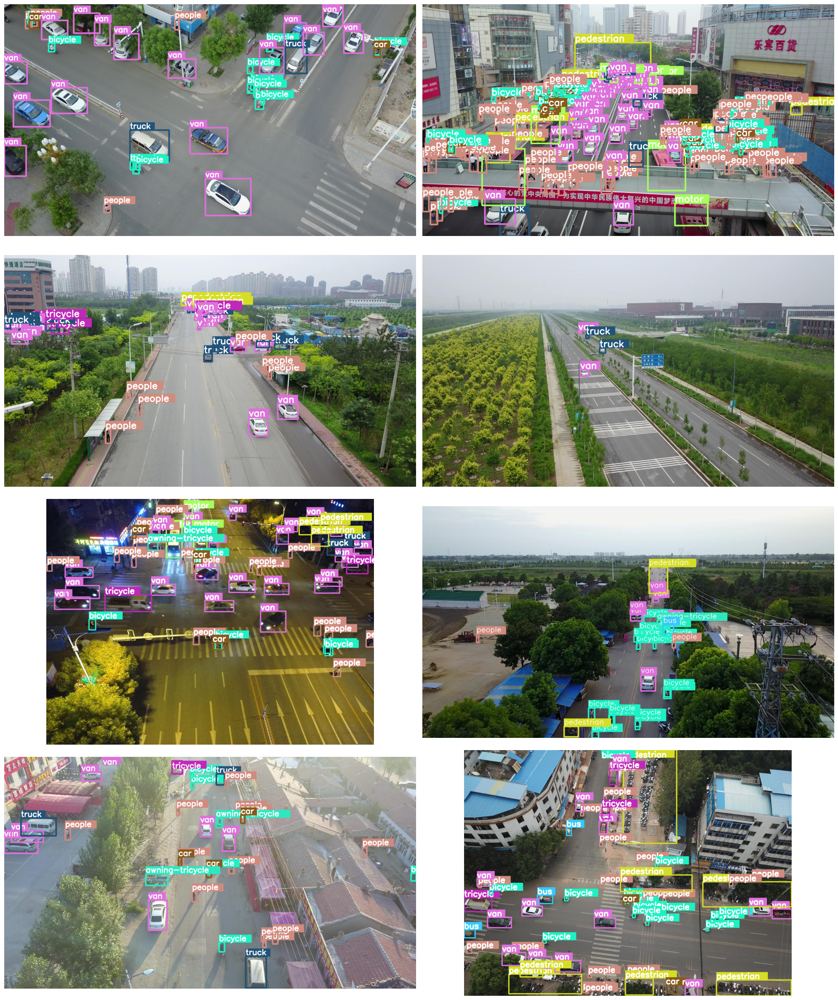

In [7]:
# Visualize a few training images.
plot(
    image_path=os.path.join(ROOT_DIR, train_imgs_dir), 
    label_path=os.path.join(ROOT_DIR, train_labels_dir),
    num_samples=8
)

In [8]:
import yaml

# Define the dataset YAML content
dataset_yaml = {
    'path': "C:\\Users\\Darpan\\Desktop\\DL Codes\\Datasets\\VisDrone",
    'train': "C:\\Users\\Darpan\\Desktop\\DL Codes\\Datasets\\VisDrone\\images1\\train",
    'val': "C:\\Users\\Darpan\\Desktop\\DL Codes\\Datasets\\VisDrone\\images1\\val",
    'test': "C:\\Users\\Darpan\\Desktop\\DL Codes\\Datasets\\VisDrone\\images1\\test_dev",
    'names': {
        0: 'pedestrian',
        1: 'people',
        2: 'bicycle',
        3: 'car',
        4: 'truck',
        5: 'tricycle',
        6: 'awning-tricycle',
        7: 'bus',
        8: 'motor',
        9: 'others'
    },
    'nc': 10

}

# Write the content to a .yaml file
with open('dataset.yaml', 'w') as file:
    yaml.dump(dataset_yaml, file)

print('Dataset YAML file created!')


Dataset YAML file created!


In [9]:
#classes = [
#    'pedestrian',
#    'people',
#    'bicycle',
#    'car',
#    'van',
#    'truck',
#    'tricycle',
#    'awning-tricycle',
#    'bus',
#    'motor'
#]


In [10]:
# Disable wandb
import os
os.environ['WANDB_DISABLED'] = 'true'

In [11]:
from ultralytics import YOLO

# Load a model (pre-trained model)
model = YOLO("yolov8l.pt")

# Now you can use the model for inference or training


In [12]:
# Use the model
results = model.train(
   data='dataset.yaml',
   imgsz=512,
   epochs=50,
   batch=16,
   name='yolov8l_v8_50e'
)  # train the model

New https://pypi.org/project/ultralytics/8.3.148 available  Update with 'pip install -U ultralytics'
Ultralytics 8.3.65  Python-3.9.21 torch-2.5.1+cu118 CUDA:0 (NVIDIA GeForce RTX 4070 Laptop GPU, 8188MiB)
engine\trainer: task=detect, mode=train, model=yolov8l.pt, data=dataset.yaml, epochs=50, time=None, patience=100, batch=16, imgsz=512, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=yolov8l_v8_50e11, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show

train: Scanning C:\Users\Darpan\Desktop\DL Codes\Datasets\VisDrone\images1\train... 0 images, 6471 backgrounds, 0 corru

train: WARNING  No labels found in C:\Users\Darpan\Desktop\DL Codes\Datasets\VisDrone\images1\train.cache. See https://docs.ultralytics.com/datasets for dataset formatting guidance.


train: New cache created: C:\Users\Darpan\Desktop\DL Codes\Datasets\VisDrone\images1\train.cache
WARNING  No labels found in C:\Users\Darpan\Desktop\DL Codes\Datasets\VisDrone\images1\train.cache, training may not work correctly. See https://docs.ultralytics.com/datasets for dataset formatting guidance.
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


C:\Users\Darpan\anaconda3\envs\gpu_Pytorch\lib\site-packages\albumentations\__init__.py:28: UserWarning: A new version of Albumentations is available: '2.0.8' (you have '2.0.2'). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
  check_for_updates()
C:\Users\Darpan\anaconda3\envs\gpu_Pytorch\lib\site-packages\ultralytics\data\augment.py:1853: UserWarning: Argument 'quality_lower' is not valid and will be ignored.
  A.ImageCompression(quality_lower=75, p=0.0),
val: Scanning C:\Users\Darpan\Desktop\DL Codes\Datasets\VisDrone\images1\val... 0 images, 548 backgrounds, 0 corrupt: 1

val: WARNING  No labels found in C:\Users\Darpan\Desktop\DL Codes\Datasets\VisDrone\images1\val.cache. See https://docs.ultralytics.com/datasets for dataset formatting guidance.
val: New cache created: C:\Users\Darpan\Desktop\DL Codes\Datasets\VisDrone\images1\val.cache
WARNING  No labels found in C:\Users\Darpan\Desktop\DL Codes\Datasets\VisDrone\images1\val.cache, training may not work correctly. See https://docs.ultralytics.com/datasets for dataset formatting guidance.


Plotting labels to runs\detect\yolov8l_v8_50e11\labels.jpg... 
zero-size array to reduction operation maximum which has no identity
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.000714, momentum=0.9) with parameter groups 97 weight(decay=0.0), 104 weight(decay=0.0005), 103 bias(decay=0.0)
TensorBoard: model graph visualization added 
Image sizes 512 train, 512 val
Using 8 dataloader workers
Logging results to runs\detect\yolov8l_v8_50e11
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/50      6.99G          0      21.66          0          0        512: 100%|██████████| 405/405 [02:26<00:00,  
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:02


RuntimeError: torch.cat(): expected a non-empty list of Tensors

In [26]:
model.val()


Ultralytics 8.3.65  Python-3.9.21 torch-2.5.1+cu118 CUDA:0 (NVIDIA GeForce RTX 4070 Laptop GPU, 8188MiB)
Model summary (fused): 268 layers, 43,610,463 parameters, 0 gradients, 164.8 GFLOPs


val: Scanning C:\Users\Darpan\Desktop\DL Codes\Datasets\Thermal\hit-uav\labels\val.cache... 287 images, 0 backgrounds, 
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 18/18 [00:04


                   all        287       2460      0.794      0.686       0.75      0.506
                Person        171       1168       0.92      0.794      0.894      0.498
                   Car        136        719      0.952       0.96      0.983      0.759
               Bicycle         53        554      0.899      0.806      0.912      0.564
          OtherVehicle          9         12      0.726      0.583      0.665      0.574
              DontCare          5          7      0.475      0.286      0.295      0.135
Speed: 0.3ms preprocess, 10.5ms inference, 0.0ms loss, 0.8ms postprocess per image
Results saved to runs\detect\yolov8l_v8_50e52


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3, 4])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x000001C59A4CA310>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
    

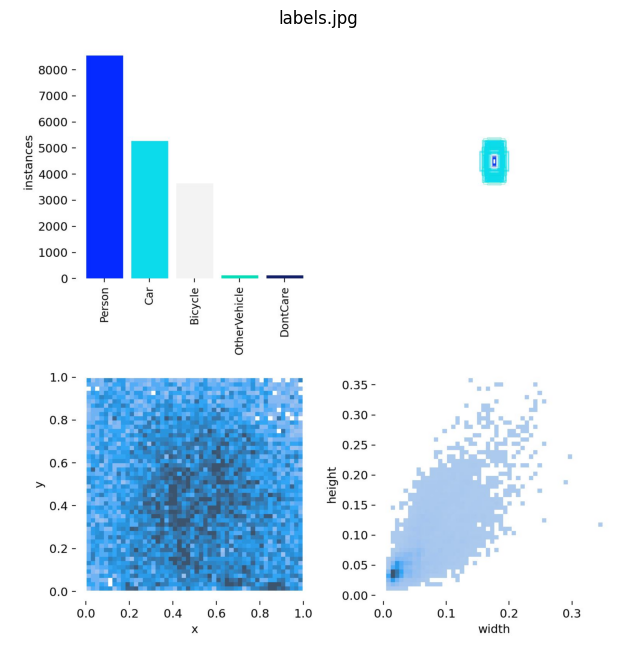

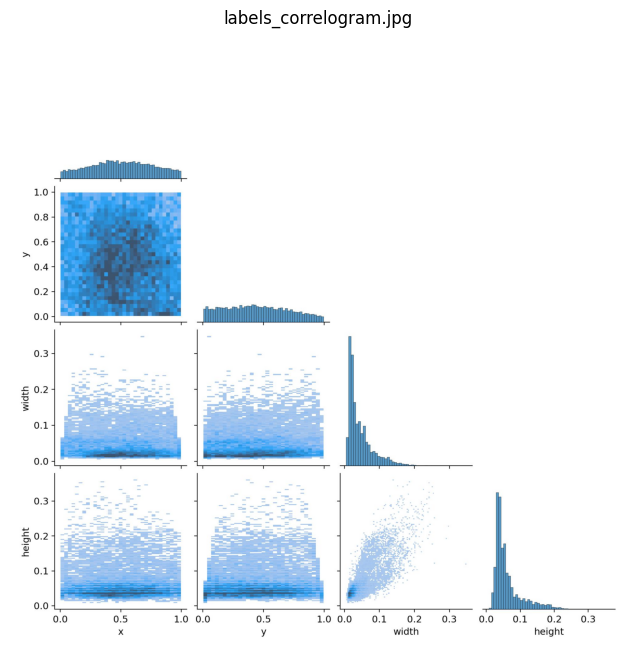

In [27]:

from imutils import paths

log_dir = "runs/detect/yolov8m_v8_50e"
for image_path in sorted(paths.list_images(log_dir)):
    image = Image.open(image_path)
    plt.figure(figsize=(12, 8))
    plt.imshow(image)
    plt.title(os.path.basename(image_path))
    plt.axis('off')
    plt.show()

In [28]:

results = model(os.path.join(ROOT_DIR, test_imgs_dir), conf=0.5, agnostic_nms=True, iou=0.5, save=True)



WARNING  inference results will accumulate in RAM unless `stream=True` is passed, causing potential out-of-memory
errors for large sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

image 1/1610 C:\Users\Darpan\Desktop\DL Codes\Datasets\VisDrone\images\test_dev\0000006_00159_d_0000001.jpg: 288x512 5 Cars, 48.2ms
image 2/1610 C:\Users\Darpan\Desktop\DL Codes\Datasets\VisDrone\images\test_dev\0000006_00611_d_0000002.jpg: 288x512 7 Cars, 11.0ms
image 3/1610 C:\Users\Darpan\Desktop\DL Codes\Datasets\VisDrone\images\test_dev\0000006_01111_d_0000003.jpg: 288x512 7 Cars, 11.6ms
image 4/1610 C:\Users\Darpan\Desktop\DL Codes\Datasets\VisDron

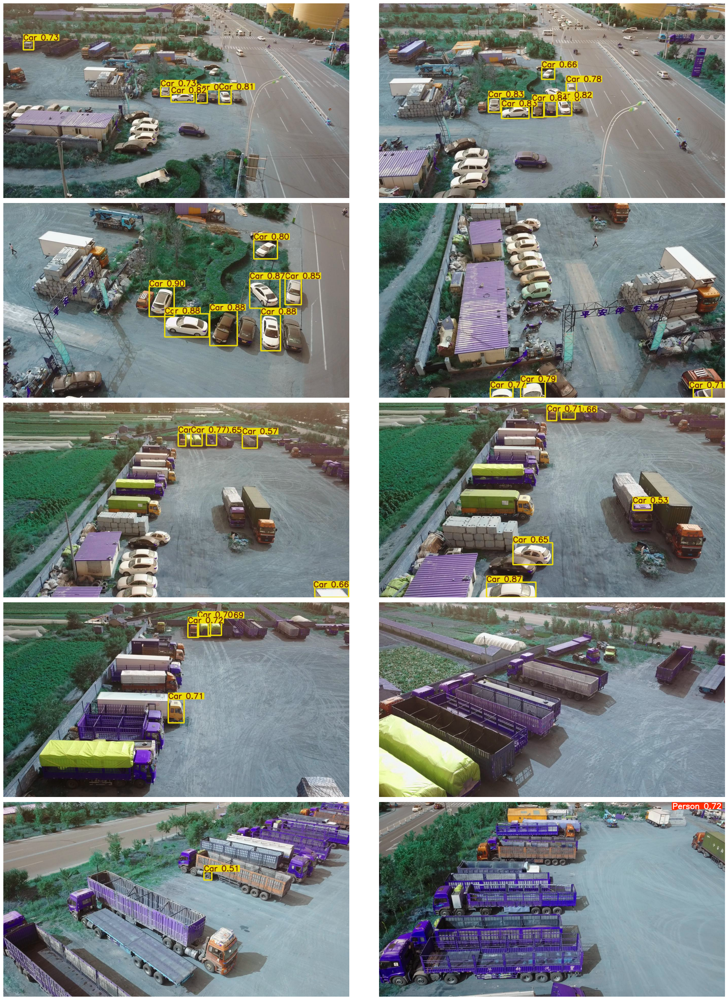

In [29]:

indices = list(range(len(results)))
random_indices = random.sample(indices, 10)
num_cols = 2
num_rows = 5

plt.figure(figsize=(12 * num_cols, 6 * num_rows))

for i, idx in enumerate(random_indices):
    image = results[i].plot()
    plt.subplot(num_rows, num_cols, i+1)
    plt.imshow(image)
    plt.axis('off')
plt.tight_layout()
plt.show()


In [30]:
ground_colors = [(255, 0, 0) for _ in range(len(classes))]

In [31]:

# Comparing a few testing images.
# plot(
#     image_path='runs/detect/yolov8m_v8_50e2',
#     label_path=os.path.join(ROOT_DIR, test_labels_dir),
#     num_samples=20,
#     classes=classes,
#     colors=ground_colors,
#     pos='below'
# )

In [32]:
success = model.export(format="onnx")  # export the model to ONNX format
success

Ultralytics 8.3.65  Python-3.9.21 torch-2.5.1+cu118 CPU (AMD Ryzen 7 7745HX with Radeon Graphics)

PyTorch: starting from 'runs\detect\yolov8l_v8_50e5\weights\best.pt' with input shape (1, 3, 512, 512) BCHW and output shape(s) (1, 9, 5376) (83.6 MB)

ONNX: starting export with onnx 1.17.0 opset 19...
ONNX: slimming with onnxslim 0.1.48...
ONNX: export success  6.2s, saved as 'runs\detect\yolov8l_v8_50e5\weights\best.onnx' (166.6 MB)

Export complete (7.0s)
Results saved to C:\Users\Darpan\runs\detect\yolov8l_v8_50e5\weights
Predict:         yolo predict task=detect model=runs\detect\yolov8l_v8_50e5\weights\best.onnx imgsz=512  
Validate:        yolo val task=detect model=runs\detect\yolov8l_v8_50e5\weights\best.onnx imgsz=512 data=dataset.yaml  
Visualize:       https://netron.app


'runs\\detect\\yolov8l_v8_50e5\\weights\\best.onnx'

In [2]:
from ultralytics import YOLO

model = YOLO("yolov8l.pt")

# Run prediction on your video
results = model.predict(
    source="C:\\Users\\Darpan\\Downloads\\Video\\BB_f91b5c53-5d52-48e2-82d1-9f25eda2b2cf.mov",
    save=True,
    conf=0.3
)





WARNING  inference results will accumulate in RAM unless `stream=True` is passed, causing potential out-of-memory
errors for large sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

video 1/1 (frame 1/848) C:\Users\Darpan\Downloads\Video\BB_f91b5c53-5d52-48e2-82d1-9f25eda2b2cf.mov: 384x640 8 cars, 5 traffic lights, 60.1ms
video 1/1 (frame 2/848) C:\Users\Darpan\Downloads\Video\BB_f91b5c53-5d52-48e2-82d1-9f25eda2b2cf.mov: 384x640 8 cars, 5 traffic lights, 18.7ms
video 1/1 (frame 3/848) C:\Users\Darpan\Downloads\Video\BB_f91b5c53-5d52-48e2-82d1-9f25eda2b2cf.mov: 384x640 8 cars, 4 traffic lights, 18.6ms
video 1/1 (frame 4/848) C:\Users